In [9]:
import rasterio as rio
import earthpy.spatial as es
import os, sys
from glob import glob
import numpy as np
from rasterio.plot import show
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import box
from tqdm import tqdm
# stack, metadata = es.stack()

In [3]:
folder_list = glob(os.path.join(
    os.getcwd(),
    'LC08*'
))

folder_list

['C:\\Users\\Jonny\\Desktop\\Jupyter Projects\\Nagasaki ML\\LC08_L2SP_113037_20210104_20210308_02_T1',
 'C:\\Users\\Jonny\\Desktop\\Jupyter Projects\\Nagasaki ML\\LC08_L2SP_113037_20210120_20210307_02_T1',
 'C:\\Users\\Jonny\\Desktop\\Jupyter Projects\\Nagasaki ML\\LC08_L2SP_113037_20210221_20210303_02_T1',
 'C:\\Users\\Jonny\\Desktop\\Jupyter Projects\\Nagasaki ML\\LC08_L2SP_113037_20210325_20210402_02_T1',
 'C:\\Users\\Jonny\\Desktop\\Jupyter Projects\\Nagasaki ML\\LC08_L2SP_113037_20211003_20211013_02_T1',
 'C:\\Users\\Jonny\\Desktop\\Jupyter Projects\\Nagasaki ML\\LC08_L2SP_113037_20211120_20211130_02_T1',
 'C:\\Users\\Jonny\\Desktop\\Jupyter Projects\\Nagasaki ML\\LC08_L2SP_113037_20211222_20211230_02_T1']

In [4]:
### WORKED PERFECTLY ###

def earthpy_cropper(folder_list, target_shapefile, cleanup = False):
    '''
    Crops all bands + the QA PIXEL band to the bounds of the specified shapefile
    
    target_dir: list of landsat folders containing images you want to crop
    target_shapefile: this should be a shapely polygon. you can get this by using .total_bounds
    cleanup: indicates whether the original raster files should be deleted. This will save a lot of disk space.
    
    returns a list of band_paths 
    '''
    # List of scenes (in my case, target_dir is the year directory)
    folder_list = folder_list
    band_paths_list = []

    # For all scenes in the folder...
    for scene in tqdm(folder_list):

        # ...finds all bands (this will not find bands with _crop.tif)
        stack_band_paths = glob(
            os.path.join(
                os.getcwd(),
                scene,
                "*B*[0-9].TIF"
            )
        )
        
        # ...finds QA PIXEL band
        stack_qa_paths = glob(
            os.path.join(
                os.getcwd(),
                scene,
                "*QA_PIXEL.TIF"
            )
        )

        paths_to_crop = stack_band_paths + stack_qa_paths

        # This function will crop all of the specified bands and write them into the specified output 
        # directory. it returns a list of file paths which you can then use as the input for es.stack 
        # in order to stack the bands into a multi band raster.

        # note that this expects a list of polygons, so you need to put it in a list even if its just the
        # one polygon
        band_paths = es.crop_all(
            paths_to_crop, scene, [target_shapefile], overwrite=True
        )
        
        band_paths_list.append(band_paths)

        # do this to delete original files to save space
        # only uncomment if you are SURE YOU WANT TO DO THIS
        if cleanup:
            for file in paths_to_crop:
                os.remove(file)
    
    # Using the band paths returned by the es.crop_all function, we can create multiband rasters in 
    # their respective folders using a single command
    
    # band paths list contains a list of all cropped filepaths PER SCENE which can use es.stack to make a stacked raster of
    # that scene
    for idx, scene in enumerate(band_paths_list):

        out_path = os.path.join(folder_list[idx], f'{folder_list[0].split("_")[3]}_STACKED.tif')
        
        # Note that we use folder[:-1] - we don't want to stack the QA PIXEL raster        
        stack, metadata = es.stack(scene[:-1], out_path = out_path)
    
    return band_paths_list

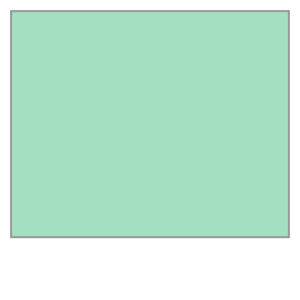

In [6]:
### Dimensions of target_shapefile based on previous knowledge

# Alternatively, 
target_shapefile = box(549000, 3599000, 635000, 3669000)

target_shapefile

In [10]:
band_path_list = earthpy_cropper(folder_list, target_shapefile, cleanup = True)

band_path_list

100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:18<00:00,  2.63s/it]


[['C:\\Users\\Jonny\\Desktop\\Jupyter Projects\\Nagasaki ML\\LC08_L2SP_113037_20210104_20210308_02_T1\\LC08_L2SP_113037_20210104_20210308_02_T1_SR_B1_crop.TIF',
  'C:\\Users\\Jonny\\Desktop\\Jupyter Projects\\Nagasaki ML\\LC08_L2SP_113037_20210104_20210308_02_T1\\LC08_L2SP_113037_20210104_20210308_02_T1_SR_B2_crop.TIF',
  'C:\\Users\\Jonny\\Desktop\\Jupyter Projects\\Nagasaki ML\\LC08_L2SP_113037_20210104_20210308_02_T1\\LC08_L2SP_113037_20210104_20210308_02_T1_SR_B3_crop.TIF',
  'C:\\Users\\Jonny\\Desktop\\Jupyter Projects\\Nagasaki ML\\LC08_L2SP_113037_20210104_20210308_02_T1\\LC08_L2SP_113037_20210104_20210308_02_T1_SR_B4_crop.TIF',
  'C:\\Users\\Jonny\\Desktop\\Jupyter Projects\\Nagasaki ML\\LC08_L2SP_113037_20210104_20210308_02_T1\\LC08_L2SP_113037_20210104_20210308_02_T1_SR_B5_crop.TIF',
  'C:\\Users\\Jonny\\Desktop\\Jupyter Projects\\Nagasaki ML\\LC08_L2SP_113037_20210104_20210308_02_T1\\LC08_L2SP_113037_20210104_20210308_02_T1_SR_B6_crop.TIF',
  'C:\\Users\\Jonny\\Desktop\\Jupy

In [26]:
def histogram_stretch(img, min_vals = None, max_vals = 99):
    """
    Performs a histogram_stretch on an image. DO NOT use this for analytical workflows - 
    this should only be used to improve image visualization
    
    img: an unmasked 3D raster 
    
    min_vals: percentile that you wish to crop to
        will be np.zeros by default
    max_vals: percentile that you wish to crop to
        will be np.nanpercentile(img, 99) by default # crops to 99th percentile
    """
    if img.ndim != 3:
        print("ValueError: Your raster must have three dimensions.")
        return
    
    # This returns the max_valth percentile
    max_vals = np.nanpercentile(img, max_vals, axis = (1,2)).reshape(img.shape[0],1,1) 
    # min_vals = np.nanmin(tcc_toa, axis = (1,2)).reshape(3,1,1) # Use this to stretch to minimum values
    if min_vals is not None:
        min_vals = np.nanpercentile(img, min_vals, axis = (1,2)).reshape(img.shape[0],1,1)
    else:
        min_vals = np.zeros(img.shape[0]).reshape(img.shape[0],1,1)
    
    # Perform normalization
    img_stretched = (img - min_vals) / (max_vals - min_vals)
    
    # Clip values above 1
    img_stretched[img_stretched > 1] = 1
    
    return img_stretched

In [21]:
# Run a conservative cloud detection
def qa_pixel_interp_conservative(number):
    '''
    Helps interpret the 16bit data in the landsat qa pixels
    
    returns True if there is mid confidence cirrus, snow/ice, cloud shadow, OR clouds
    '''
    binary = bin(number)[2:].zfill(16)
    
    # if high confidence cirrus, snow/ice, cloud shadow, and clouds
    # 01 - low, 10 - medium, 11 - high
    if int(binary[:2]) > 10:
        return True
    elif int(binary[2:4]) > 10:
        return True
    elif int(binary[4:6]) > 10:
        return True
    elif int(binary[6:8]) > 10:
        return True
    else:
        return False

def apply_array_func(func, x):
    '''
    Applies a function element-wise across a 1D array
    '''
    return np.array([func(xi) for xi in x])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


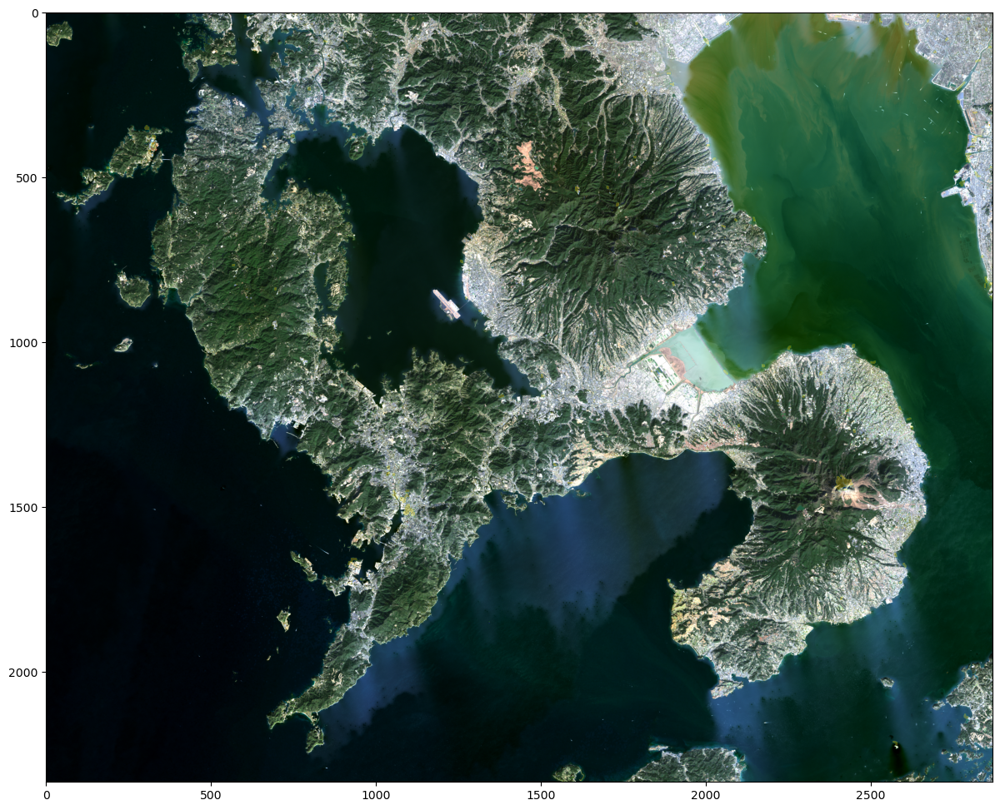

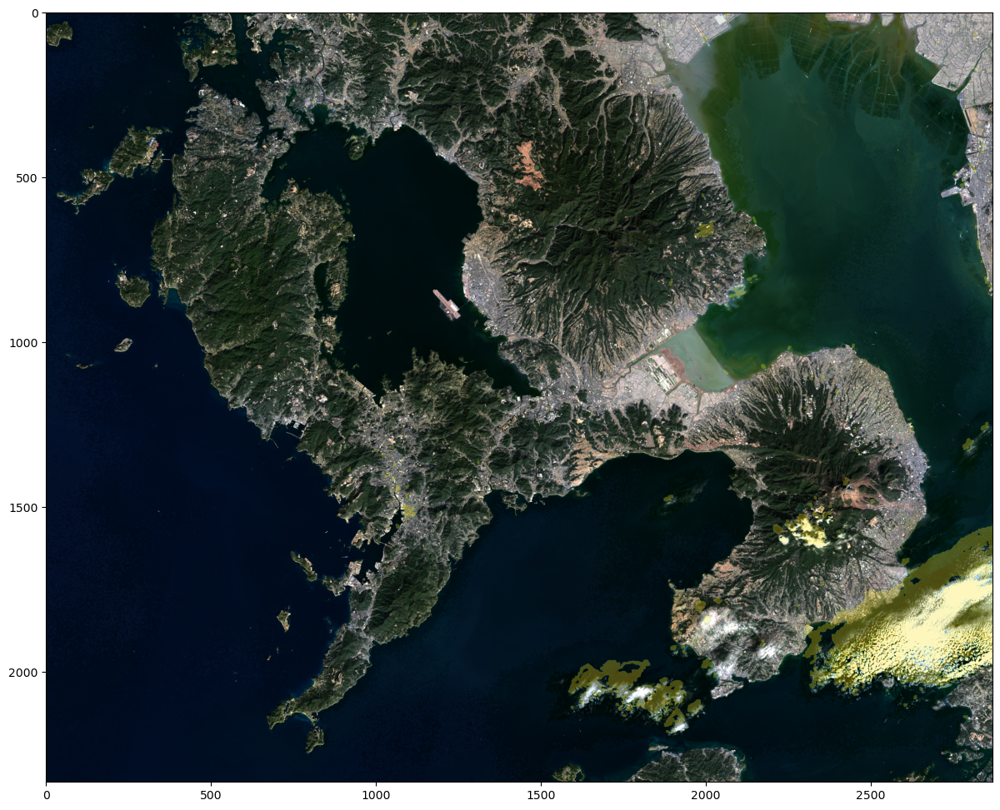

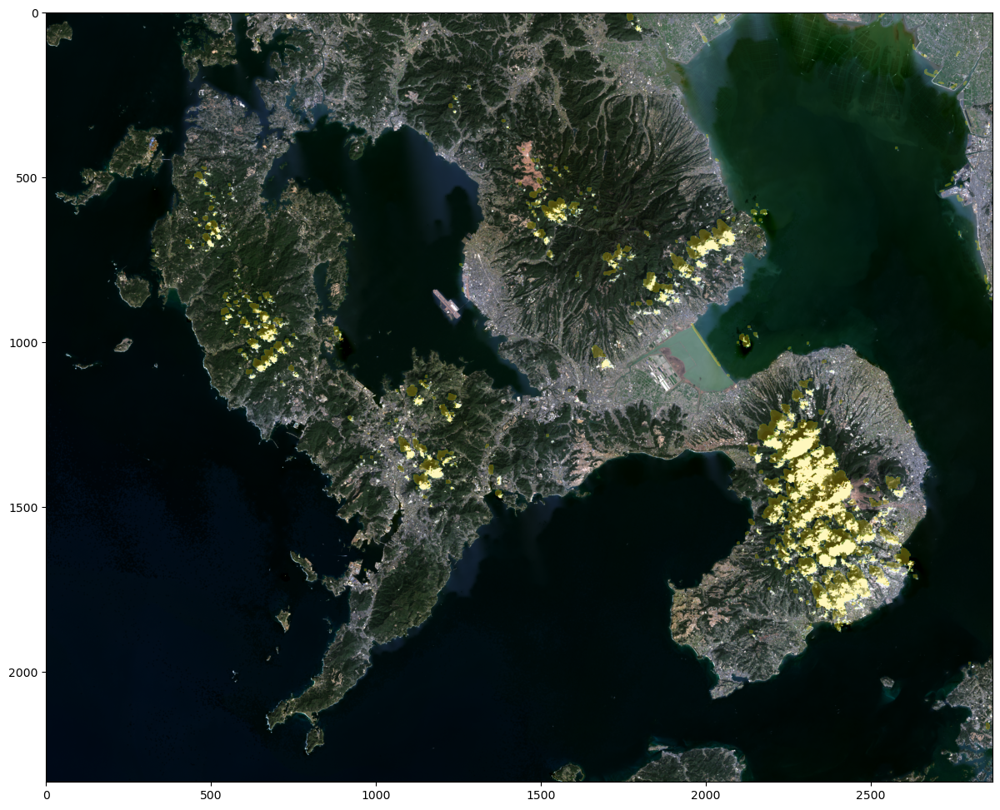

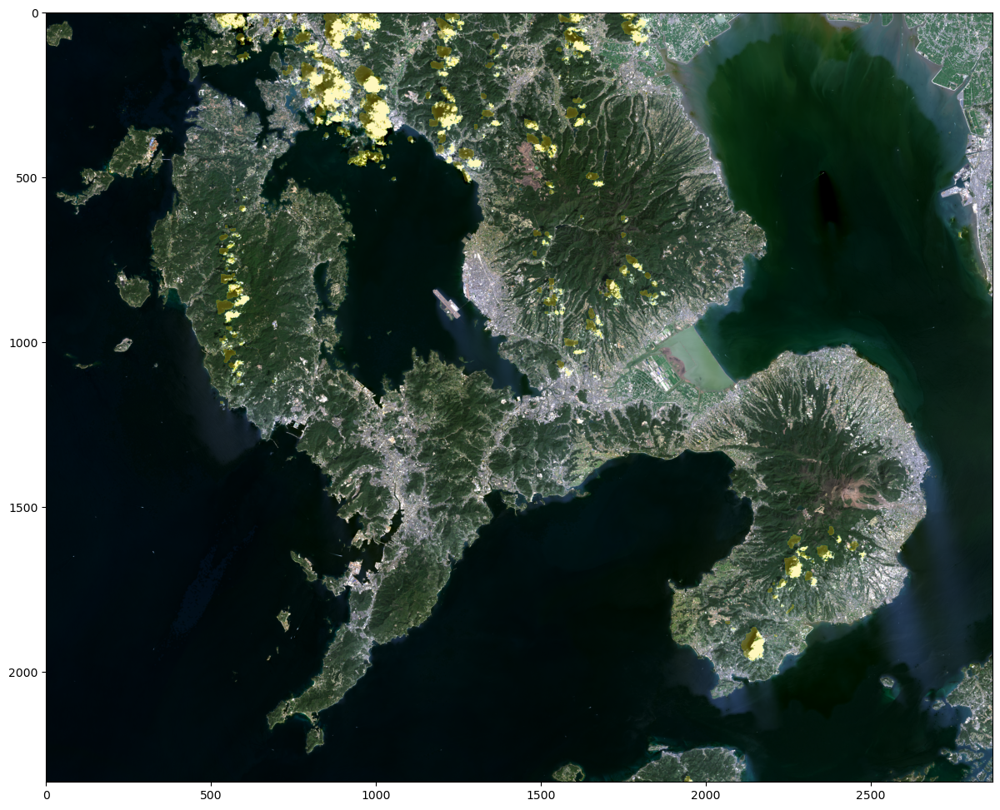

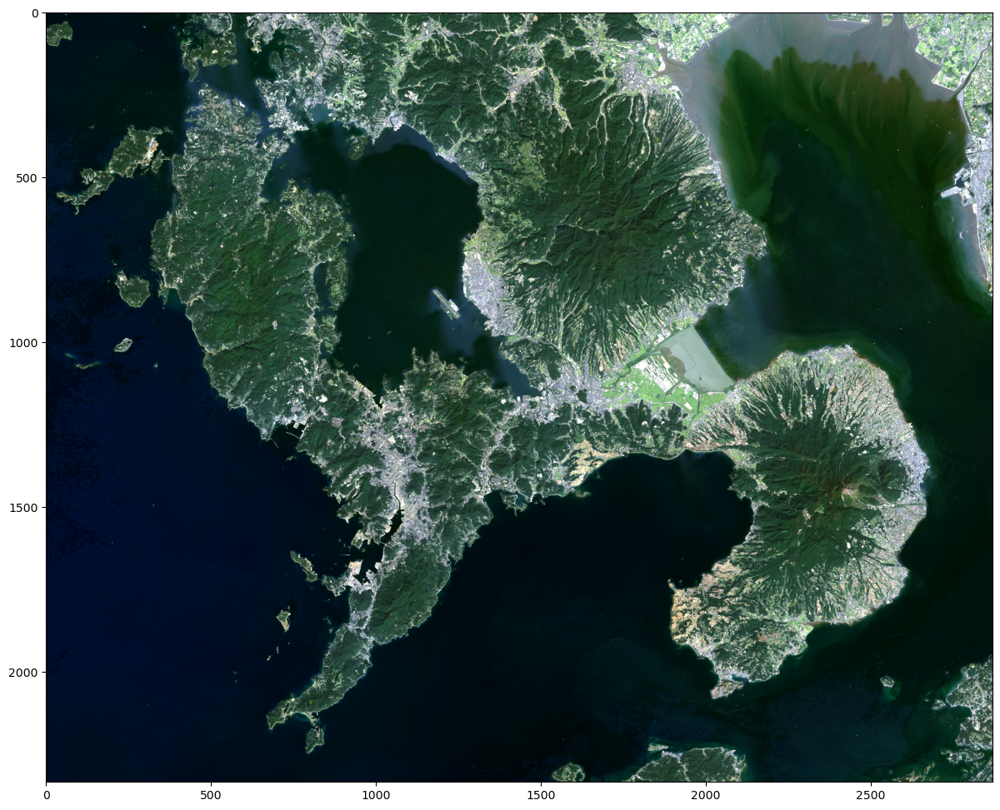

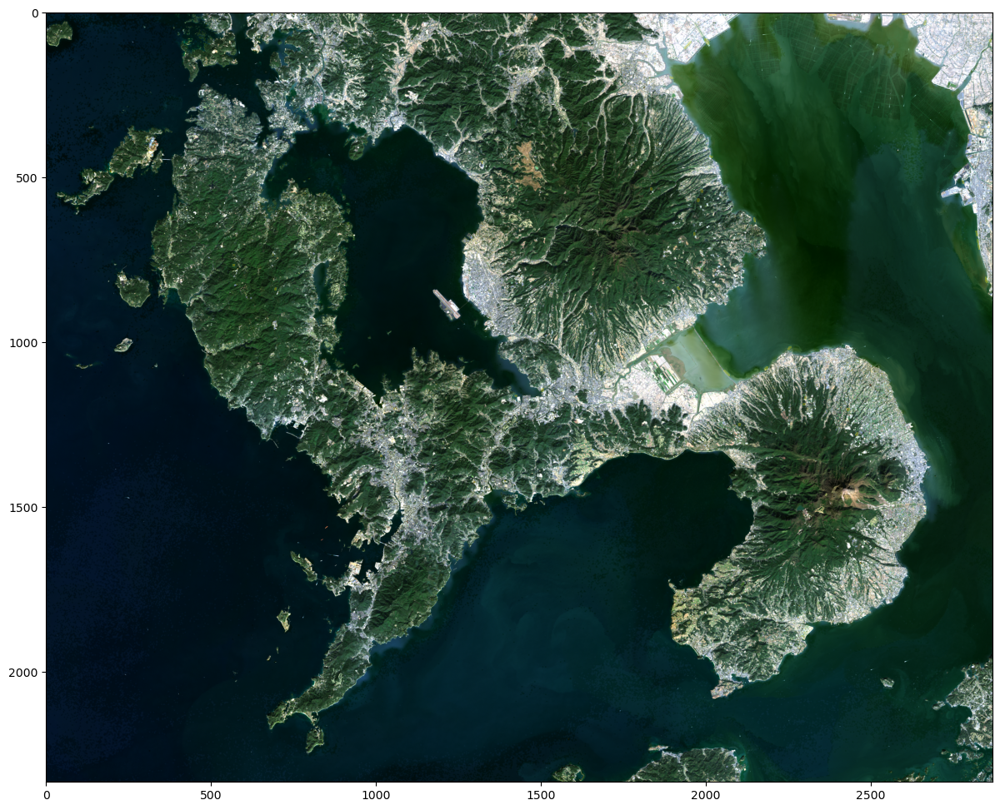

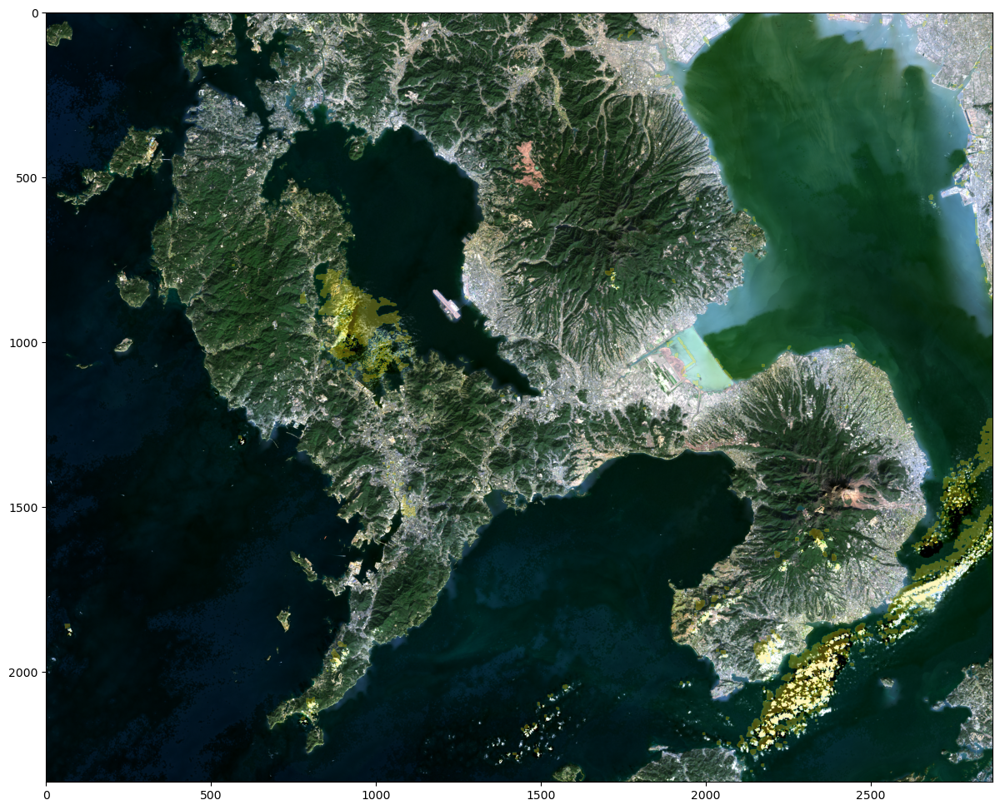

In [28]:
from rasterio.plot import reshape_as_image

for folder in folder_list:
    stacked_mb_raster = glob(os.path.join(os.getcwd(), folder, '*_STACKED.tif'))
    qa_raster_path = glob(os.path.join(os.getcwd(), folder, '*QA*_crop.tif'))
    
    with rio.open(stacked_mb_raster[0]) as src:
        profile = src.profile
        stack = src.read()
        src.close()
        
    with rio.open(qa_raster_path[0]) as src:
        qa_raster = src.read(1)
        src.close()
        
    scaled_stack = stack * 0.0000275 - 0.2
    
    # classify the QA raster using conservative cloud estimates
    unique_vals = np.unique(qa_raster)
    masked_vals = apply_array_func(qa_pixel_interp_conservative, unique_vals)
    masked_vals = unique_vals[masked_vals]
    cl_mask = np.isin(qa_raster, masked_vals)
    
    fig, ax = plt.subplots(figsize = (16,12))
    
    
    # ax.axis('off') # uncomment if you don't want axes - axes useful for slicing numpy arrays
    ax.imshow(reshape_as_image(histogram_stretch(scaled_stack[[3,2,1],...])))
    ax.imshow(cl_mask, alpha = 0.3 * cl_mask)
    
    out_path = os.path.join(folder, f'{folder.split("_")[3]}_TCC_axes.png')
    
    plt.savefig(out_path, dpi=300, bbox_inches='tight')
    

In [ ]:
stack_mask = stack == 0
stack_masked = np.ma.masked_array(stack, mask = stack_mask)

stack_masked

In [22]:
glob(os.path.join(folder, '*QA*_crop.tif'))

['C:\\Users\\Jonny\\Desktop\\Jupyter Projects\\Nagasaki ML\\LC08_L2SP_113037_20211222_20211230_02_T1\\LC08_L2SP_113037_20211222_20211230_02_T1_QA_PIXEL_crop.TIF']

In [4]:
with rio.open('LC09_L2SP_113037_20230510_20230512_02_T1/Nagasaki_STACKED.tif') as src:
    bounds = src.bounds
    profile = src.profile
    stack = src.read()
    src.close()

In [ ]:
scaled_stack = stack * 0.0000275 - 0.2

fig, ax = plt.subplots(figsize = (16,12))
show(histogram_stretch(scaled_stack[[3,2,1],...], 1, 99), ax = ax)
# show(scaled_stack[[3,2,1],...], ax = ax)

In [ ]:
metadata

In [ ]:
### for cropping
with rio.open('LC09_L2SP_113037_20230510_20230512_02_T1/Nagasaki_STACKED.tif') as src:
    bounds = src.bounds
    profile = src.profile
    src.close()
    
print(bounds)
print(profile)

CPU times: total: 11.8 s
Wall time: 14.7 s


<Axes: >

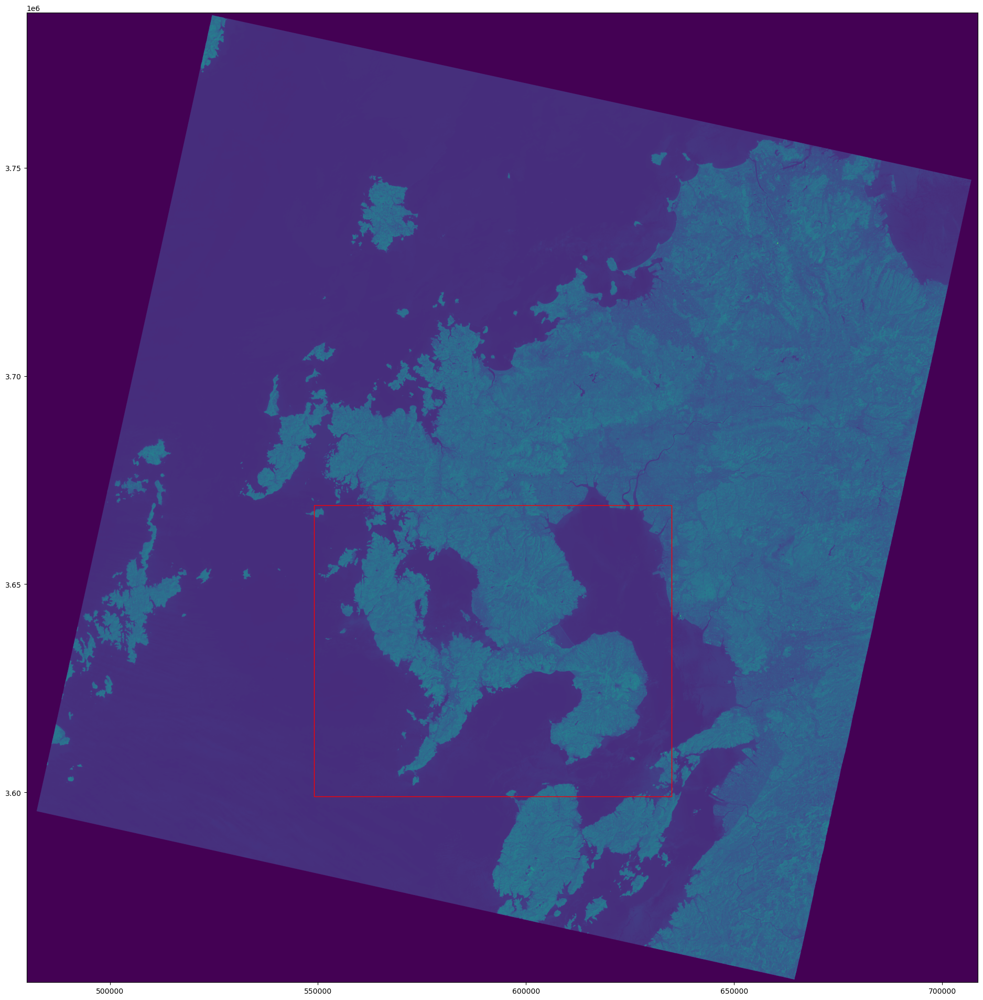

In [9]:
%%time
### Check extent of shapefile to ensure correct cropping extent
scaled_stack = stack * 0.0000275 - 0.2

target_shapefile = box(549000, 3599000, 635000, 3669000)

df = gpd.GeoDataFrame({"id":1,"geometry":[target_shapefile]})

fig, ax = plt.subplots(figsize = (24,24))
# remember to use transform argument to set the raster image to coordinates
show(scaled_stack[4], ax = ax, transform = profile['transform'])
df.plot(color = 'none', edgecolor = 'red', ax = ax)

In [10]:
### crop to study area
band_paths = es.crop_all(
    paths_to_crop, 'LC09_L2SP_113037_20230510_20230512_02_T1', [target_shapefile], overwrite=True
)

In [13]:
### Stack cropped data
stack, metadata = es.stack(band_paths[:-1], out_path = 'LC09_L2SP_113037_20230510_20230512_02_T1/Nagasaki_CROPPED_STACKED.tif')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


<Axes: >

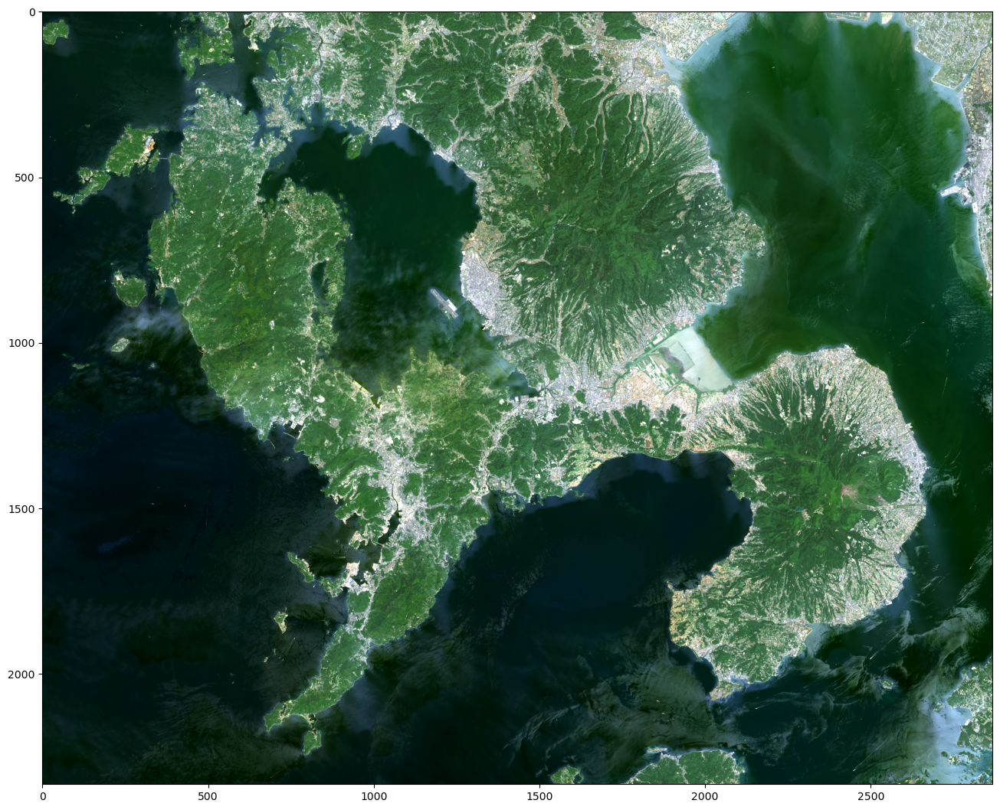

In [27]:
scaled_stack = stack * 0.0000275 - 0.2

fig, ax = plt.subplots(figsize = (16,16))
show(histogram_stretch(scaled_stack[[3,2,1],...]), ax = ax)

(<Figure size 1200x1200 with 4 Axes>,
 array([[<Axes: >, <Axes: >],
        [<Axes: >, <Axes: >]], dtype=object))

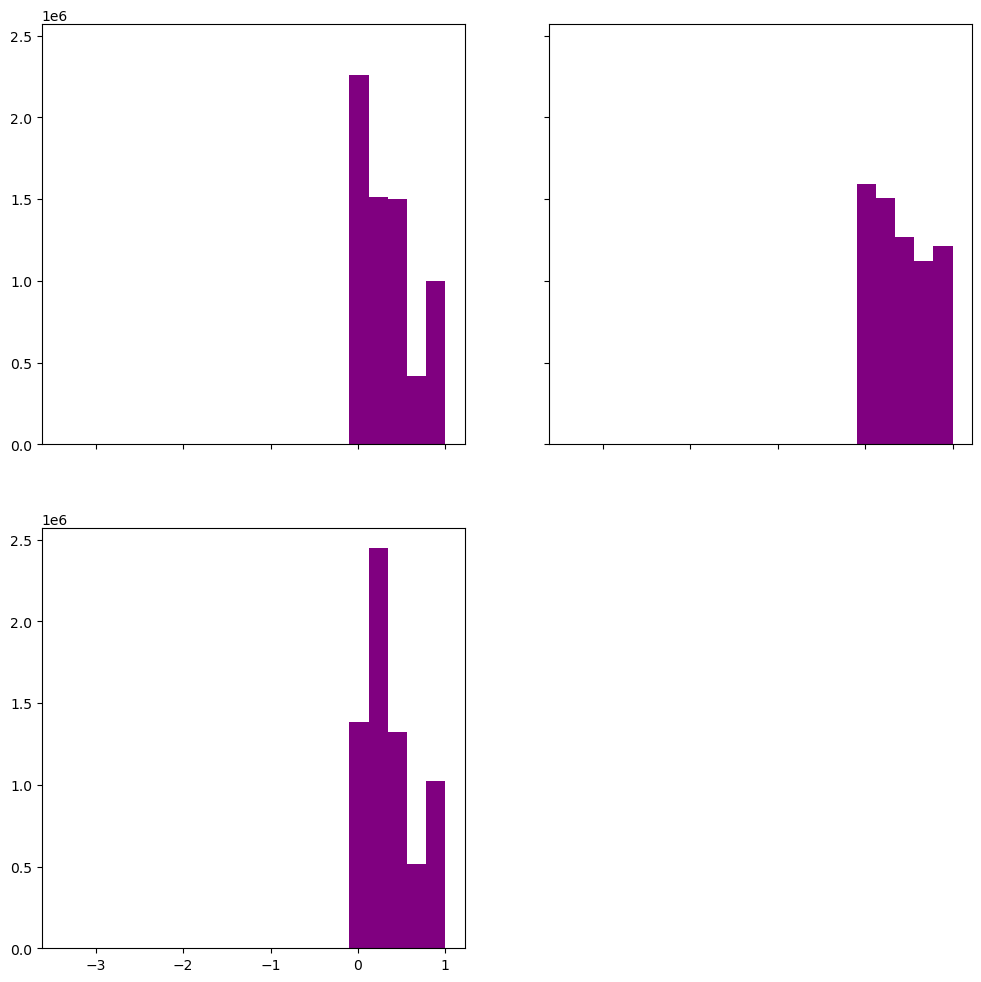

In [25]:
import earthpy.plot as ep

stretch = histogram_stretch(scaled_stack[[3,2,1],...], min_vals = 1, max_vals = 90)

ep.hist(stretch)